In [ ]:
import numpy as np
import pandas as pd
# Define the EEG data file path

eeg_data_path = 'data/\WS_R_4_250328163152.csv'

# Load the EEG data

eeg_data = (pd.read_csv(eeg_data_path))


sampling_frequency =  len(eeg_data)/eeg_data['Timestamp'].iloc[-1] 

# check if eeg_data['Action2'] has any NaN values

pd.isna(eeg_data['Action2'].iloc[0])
sampling_frequency

1450.850989927058

In [46]:
#!pip install plotly
#import plotly 
#import plotly.express as px

In [47]:
# display the data from channel 1 and channel 2 versus timestamp

import plotly.express as px
import nbformat 

fig = px.line()
fig.add_scatter(x=eeg_data['Timestamp'], y=eeg_data['Channel1'], marker={'color':'red'}, name='Channel1')
fig.add_scatter(x=eeg_data['Timestamp'], y=eeg_data['Channel2'], marker={'color':'blue'}, name ='Channel2')

for i in range(len(eeg_data['Action2']) - 1):
    if eeg_data['Action2'].iloc[i]!= eeg_data['Action2'].iloc[i+1] and not pd.isna(eeg_data['Action2'].iloc[i]):
        fig.add_vline(x=eeg_data['Timestamp'].iloc[i+1], line_width=2, line_color='black')
        # add the labels to what the new action label is
fig.update_layout(xaxis_title='Time (s)', yaxis_title='Magnitude')

# Display the final figure
fig.show()

# Also add vertical lines whenever Action1 changes from one label to another
fig2 = px.line()
fig2.add_scatter(x=eeg_data['Timestamp'], y=eeg_data['Channel1'], marker={'color':'red'}, name='Channel1')

for i in range(len(eeg_data['Action2']) - 1):
    if eeg_data['Action2'].iloc[i]!= eeg_data['Action2'].iloc[i+1] and not pd.isna(eeg_data['Action2'].iloc[i]):
        fig2.add_vline(x=eeg_data['Timestamp'].iloc[i+1], line_width=2, line_color='black')
        # add the labels to what the new action label is
        fig2.add_annotation(x=eeg_data['Timestamp'].iloc[i], y=eeg_data['Channel1'].iloc[i], text=eeg_data['Action2'].iloc[i], showarrow=False)
fig2.update_layout(xaxis_title='Time (s)', yaxis_title='Magnitude')

fig2.show()

fig3 = px.line()
fig3.add_scatter(x=eeg_data['Timestamp'], y=eeg_data['Channel2'], marker={'color':'blue'}, name ='Channel2')

for i in range(len(eeg_data['Action2']) - 1):
    if eeg_data['Action2'].iloc[i]!= eeg_data['Action2'].iloc[i+1] and not pd.isna(eeg_data['Action2'].iloc[i]):
        fig3.add_vline(x=eeg_data['Timestamp'].iloc[i+1], line_width=2, line_color='black')
        # add the labels to what the new action label is
        fig3.add_annotation(x=eeg_data['Timestamp'].iloc[i], y=eeg_data['Channel2'].iloc[i], text=eeg_data['Action2'].iloc[i], showarrow=False)
fig3.update_layout(xaxis_title='Time (s)', yaxis_title='Magnitude')

fig3.show()

In [48]:
# plot the fft of the EEG data, sampled at 1000 Hz

import scipy.fft
import plotly.graph_objects as go

start_idx = 0
end_idx = 1000
eeg_data_fft = scipy.fft.fft(eeg_data['Channel1'][start_idx:end_idx].to_numpy())
frequency_axis = np.linspace(0, sampling_frequency, len(eeg_data_fft[start_idx:end_idx]))

fig = go.Figure(data=[go.Scatter(x=frequency_axis, y=abs(eeg_data_fft[0:end_idx//2]))])

fig.update_layout(xaxis_title='Normalized Frequency (Hz)', yaxis_title='Magnitude')




In [49]:
#highpass the signal from 0 to 1 Hz using scipy's butterworth filter
start_idx = 0 #int(11 * sampling_frequency)
end_idx = len(eeg_data)#int(18 * sampling_frequency)

print(start_idx, end_idx)
# sampling_frequency = 1
from scipy.signal import butter, filtfilt

def butterworth_highpass(data, cutoff_frequency, sampling_frequency, order=1):
    nyquist_frequency = sampling_frequency / 2
    lowpass_frequency = cutoff_frequency * sampling_frequency

    b, a = butter(order, lowpass_frequency / nyquist_frequency, btype='highpass')
    filtered_data = filtfilt(b, a, data)
    return filtered_data


# Add a bandreject filter of bandwidth 0.46 to 0.48 of the normalized frequency

def butterworth_bandreject(data, lower_frequency, upper_frequency, sampling_frequency, order=2):
    nyquist_frequency = sampling_frequency / 2
    lowpass_frequency = lower_frequency * sampling_frequency

    highpass_frequency = upper_frequency * sampling_frequency
    b, a = butter(order, [lowpass_frequency / nyquist_frequency, highpass_frequency / nyquist_frequency], btype='bandstop')
    filtered_data = filtfilt(b, a, data)
    return filtered_data

# WITH DC FILTERING
filtered_eeg_data_ch1 = butterworth_highpass(eeg_data['Channel1'].iloc[start_idx:end_idx], 0.025, sampling_frequency)
# filtered_eeg_data_ch1 = butterworth_bandreject(filtered_eeg_data_ch1, 0.467, 0.48, sampling_frequency)
filtered_eeg_data_ch2 = butterworth_highpass(eeg_data['Channel2'].iloc[start_idx:end_idx], 0.025, sampling_frequency)
# filtered_eeg_data_ch2 = butterworth_bandreject(filtered_eeg_data_ch2, 0.467, 0.48, sampling_frequency)
    
# WITHOUT DC FILTERING
# filtered_eeg_data_ch1 = butterworth_bandreject(eeg_data['Channel1'].iloc[start_idx:end_idx], 0.467, 0.48, sampling_frequency)
# filtered_eeg_data_ch2 = butterworth_bandreject(eeg_data['Channel2'].iloc[start_idx:end_idx], 0.467, 0.48, sampling_frequency)

# filtered_eeg_data_ch1 = butterworth_bandreject(filtered_eeg_data_ch1, 0.052, 0.062, sampling_frequency)
# filtered_eeg_data_ch2 = butterworth_bandreject(filtered_eeg_data_ch2, 0.052, 0.062, sampling_frequency)


# plot the fft of the filtered EEG data
# and plot below it in another subplot the filtered eeg data


fig = px.line()

eeg_data_fft_filtered_ch1 = scipy.fft.fft(filtered_eeg_data_ch1)
frequency_axis = np.linspace(0, 1, len(eeg_data_fft_filtered_ch1))
eeg_data_fft_filtered_ch2 = scipy.fft.fft(filtered_eeg_data_ch2)

fig.add_scatter(x=frequency_axis, y=abs(eeg_data_fft_filtered_ch1), name='Channel 1')
fig.add_scatter(x=frequency_axis, y=abs(eeg_data_fft_filtered_ch2), name='Channel 2')

fig.update_layout(xaxis_title='Normalized Frequency (Hz)', yaxis_title='Magnitude')

fig.show()

fig2 = px.line()
for i in range(end_idx -start_idx-1):
    if eeg_data['Action2'].iloc[i]!= eeg_data['Action2'].iloc[i+1] and not pd.isna(eeg_data['Action2'].iloc[i]):
        fig2.add_vline(x=eeg_data['Timestamp'].iloc[i+1], line_width=2, line_color='black')
        # add the labels to what the new action label is
        fig2.add_annotation(x=eeg_data['Timestamp'].iloc[i], y=eeg_data['Channel2'].iloc[i], text=eeg_data['Action2'].iloc[i], showarrow=False)

for i in range(end_idx -start_idx-1):
    if eeg_data['Action1'].iloc[i]!= eeg_data['Action1'].iloc[i+1] and not pd.isna(eeg_data['Action1'].iloc[i]):
        fig2.add_vline(x=eeg_data['Timestamp'].iloc[i+1], line_width=2, line_color='black')
        # add the labels to what the new action label is
        fig2.add_annotation(x=eeg_data['Timestamp'].iloc[i], y=eeg_data['Channel2'].iloc[i], text=eeg_data['Action1'].iloc[i], showarrow=False)



fig2.add_scatter(x = np.linspace(0, end_idx / sampling_frequency, end_idx - start_idx), y=filtered_eeg_data_ch1, fillcolor='blue', name = 'Channel 1'  )
fig2.add_scatter(x = np.linspace(0, end_idx /sampling_frequency, end_idx - start_idx), y=filtered_eeg_data_ch2, fillcolor='red', name = 'Channel 2'  )
fig2.update_layout(xaxis_title='Time (s)', yaxis_title='Magnitude')


fig2.show()

0 75186


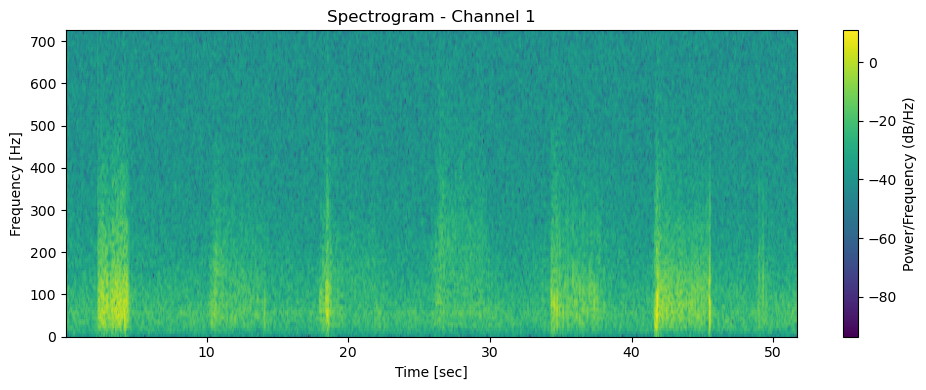

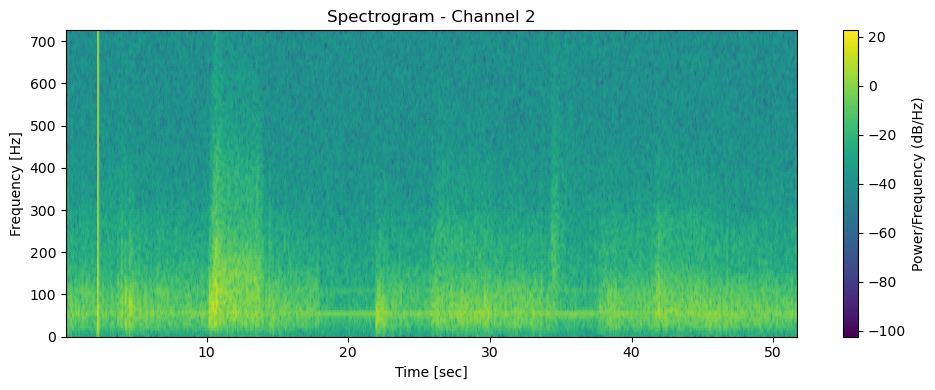

In [50]:
# plot the spectrogram of the filtered EEG data

import matplotlib.pyplot as plt
# Generate spectrogram
f, t, Sxx = scipy.signal.spectrogram(filtered_eeg_data_ch1, sampling_frequency, nperseg= 200, noverlap=100)

# Plot it
plt.figure(figsize=(10, 4))
plt.pcolormesh(t, f, 10 * np.log10(Sxx), shading='gouraud')  # log scale for better contrast
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.title('Spectrogram - Channel 1')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.tight_layout()
plt.show()

f2, t2, Sxx2 = scipy.signal.spectrogram(filtered_eeg_data_ch2, sampling_frequency, nperseg= 200, noverlap=100)

# Plot it
plt.figure(figsize=(10, 4))
plt.pcolormesh(t2, f2, 10 * np.log10(Sxx2), shading='gouraud')  # log scale for better contrast
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.title('Spectrogram - Channel 2')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.tight_layout()
plt.show()
